#Introduction

Project Overview: Predicting Risk in Shelter Animals

Background: This project addresses a critical challenge in animal shelter management: identifying animals at high risk of negative outcomes upon intake. Using the Louisville Metro KY - Animal Service Intake and Outcome dataset, we aim to build a predictive model that classifies whether an animal is "At-Risk."

Definition of "At-Risk": In this study, an animal is defined as "At-Risk" if its final outcome is categorized as Euthanasia, Died, or Disposal.

Objectives:

Perform a comprehensive Exploratory Data Analysis (EDA) to identify key risk factors (e.g., breed, intake type, biting history).

Implement and compare various machine learning models (Logistic Regression, Random Forest, XGBoost) to predict the outcome.

Use clustering techniques to identify common "risk profiles" of animals entering the shelter.

Impact: Early prediction of risk allows shelter staff to prioritize resources, implement targeted behavioral or medical interventions, and ultimately increase the number of successful adoptions and rescues.

In [1]:
!pip install catboost -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 8.0 MB/s eta 0:00:00


In [2]:
pip install kmodes -q

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import lightgbm as lgb
import shap

from scipy.stats import randint, loguniform, uniform
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, recall_score, make_scorer
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as ImbPipeline
from google.colab import files
from sklearn.inspection import permutation_importance
from sklearn.metrics import average_precision_score, precision_recall_fscore_support
from kmodes.kmodes import KModes
from catboost import CatBoostClassifier

In [4]:
import gdown
url = "https://drive.google.com/uc?id=1zypQlUIQLApHw5sfGjlEFHP1b7lEvlki"
output = "Animal_IO_Data.csv"
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1zypQlUIQLApHw5sfGjlEFHP1b7lEvlki
To: /content/Animal_IO_Data.csv
100%|██████████| 4.88M/4.88M [00:00<00:00, 23.0MB/s]


'Animal_IO_Data.csv'

In [5]:
data_frame = pd.read_excel('Animal_IO_Data.csv')

In [6]:
df = data_frame.copy()

---

# Cleaning The Data #

Data Preprocessing and Feature Engineering

In this stage, we prepare the raw data for analysis and modeling. The raw dataset contains several categorical variables and timestamps that require transformation.

In [7]:
df.outtype.unique()

array(['EUTH', 'FOSTER', 'ADOPTION', 'DISPOSAL', 'RTO', 'DIED', 'SNR',
       'TNR', 'RTF', 'TRANSPORT', nan, 'TRANSFER', 'RELEASE', 'LOST',
       'FOUND EXP'], dtype=object)

In [8]:
df = df[df.outtype.notnull()]

In [9]:
df['indate'] = pd.to_datetime(df['indate']).dt.normalize()
df['outdate'] = pd.to_datetime(df['outdate']).dt.normalize()
df.sort_values(by='indate', inplace=True)

Identifying Returning Animals > We create a first_time binary flag to distinguish between new arrivals and animals that have been in the shelter before. This is derived by checking for duplicated Animal IDs.

In [10]:
df['first_time'] = (~df.duplicated('animalid')).astype(int)
df.sort_values(by='ObjectId', inplace=True)

In [11]:
df = df[~df['kennel'].isin(['NECROPSY', 'FREEZER', 'TNR/SNR'])]
df = df[df['surreason'] != 'DOA']
df = df[~df['surreason'].str.contains('AUTH', case=False, na=False)]
df = df[df['intype'] != 'DISPOSAL']
df = df[df['insubtype'] != 'EUTH REQ']

Standardizing Categorical Categories > To reduce noise and improve model stability, we simplify categorical variables:

Animal Type: Rare species are grouped into an "OTHER" category.

Pet Size: Young animals ("PUPPY", "KITTN") are merged into a single "PUPPY/KITTN" group, reflecting their similar risk profiles.

In [12]:
df['animaltype'] = df['animaltype'].replace('LIVESTOCK', 'OTHER')
df['petsize'] = df['petsize'].replace(['PUPPY', 'KITTN'], 'PUPPY/KITTN')

Feature Extraction: Breed Complexity > We extract the mixed_breed feature from the raw text to determine if an animal is a purebred or a mix. Mixed breeds often face different adoption challenges than purebreds.

In [13]:
df['mixed_breed'] = np.where(df['breed'].str.contains('/|mix', case=False), 1, 0)

Defining the Target Variable (Risk) > Our primary goal is to predict high-risk outcomes. We define an animal as "At-Risk" (1) if its outcome is Euthanasia, Death, or Disposal. All other outcomes are classified as "Safe" (0).

In [14]:
at_risk_outtypes = ['DISPOSAL', 'EUTH', 'DIED']
df['will_die'] = np.where(
    (df['outtype'].isin(at_risk_outtypes)) | (df['outsubtype']=='HOSPICE'),
    1, 0
)

Temporal Feature Engineering > Raw dates are converted into datetime objects to extract the Month and Season of intake. This helps the model capture seasonal trends.

In [15]:
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Fall'

df['season'] = df['indate'].dt.month.apply(get_season)

In [16]:
df.isnull().sum()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 43505 entries, 1 to 64667
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   kennel         43505 non-null  object        
 1   animalid       43505 non-null  object        
 2   jurisdiction   43505 non-null  object        
 3   intype         43505 non-null  object        
 4   insubtype      43349 non-null  object        
 5   indate         43505 non-null  datetime64[ns]
 6   surreason      43505 non-null  object        
 7   outtype        43505 non-null  object        
 8   outsubtype     39244 non-null  object        
 9   outdate        43504 non-null  datetime64[ns]
 10  animaltype     43505 non-null  object        
 11  sex            43505 non-null  object        
 12  bites          43502 non-null  object        
 13  petsize        43501 non-null  object        
 14  color          43504 non-null  object        
 15  breed          43504 non

Ensuring Data Integrity > To maintain a high-quality dataset for the machine learning models, we remove records with critical missing values in key features.

In [17]:
all_columns = df.columns.tolist()
exclude_columns = ['sourcezipcode', 'insubtype', 'outsubtype']
columns_to_check = [col for col in all_columns if col not in exclude_columns]
df.dropna(subset=columns_to_check, inplace=True)

In [18]:
#--- downloading the new data - optional---

# df_new = df.copy()
# df_clean.to_csv('clean_animal_data.csv', index=False)
# files.download('clean_animal_data.csv')

# Visualizations #

  ### Target Variabe Distribution

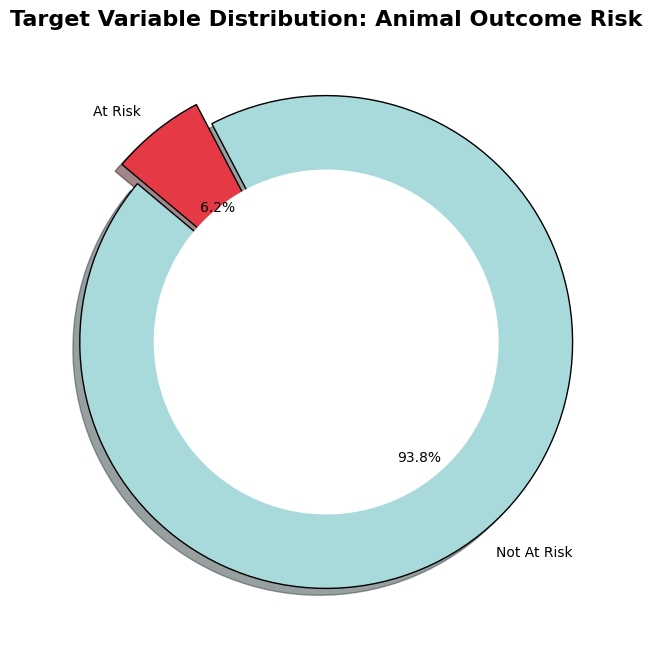

In [19]:
plt.figure(figsize=(8, 8))

counts = df['will_die'].value_counts()
labels = ['Not At Risk', 'At Risk']
colors_me = ['#a8dadc', '#e63946']
explode = (0, 0.1)
plt.pie(counts, labels=labels, autopct='%1.1f%%', startangle=140,
        colors=colors_me, explode=explode, shadow=True, wedgeprops={'edgecolor': 'black'})

centre_circle = plt.Circle((0,0), 0.70, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Target Variable Distribution: Animal Outcome Risk', fontsize=16, fontweight='bold')
plt.show()

This graph shows the distribution of our target variable.

### Risk rate analysis by animal type

/tmp/ipython-input-545940490.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=risk_rate_animal.index, y=risk_rate_animal.values, palette='viridis')


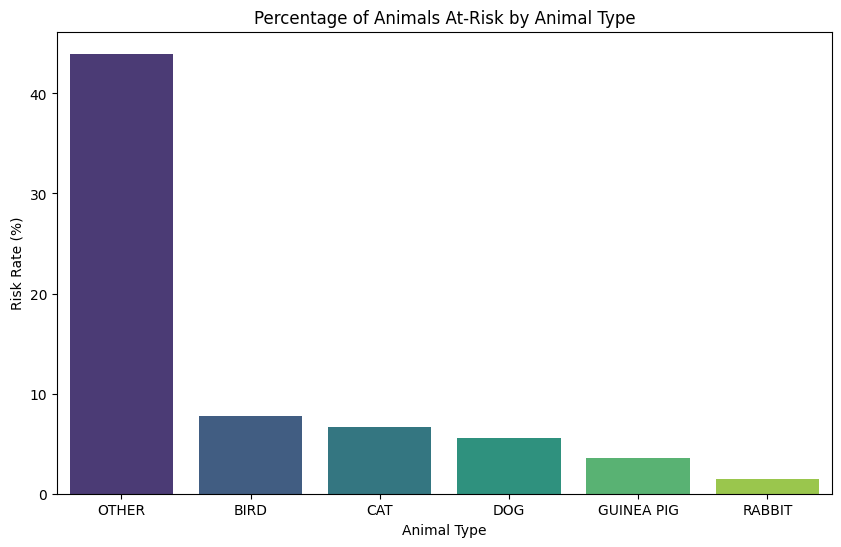

In [20]:
plt.figure(figsize=(10, 6))
risk_rate_animal = df.groupby('animaltype')['will_die'].mean().sort_values(ascending=False) * 100
sns.barplot(x=risk_rate_animal.index, y=risk_rate_animal.values, palette='viridis')

plt.title('Percentage of Animals At-Risk by Animal Type')
plt.ylabel('Risk Rate (%)')
plt.xlabel('Animal Type')
plt.show()

This graph shows the percentage of animals that were defined as “at risk” (death, anesthesia, or castration) out of the total animals of each type. Unlike a regular quantitative graph, here you can see which types of animals are statistically more vulnerable. For example, if the percentage of risk among cats is significantly higher than dogs, our future model will give more weight to this variable in the decision-making process.


### The relationship between the method of entry into the shelter (Intype) and risk

/tmp/ipython-input-3766064495.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=risk_rate_intype.index, y=risk_rate_intype.values, palette='magma')


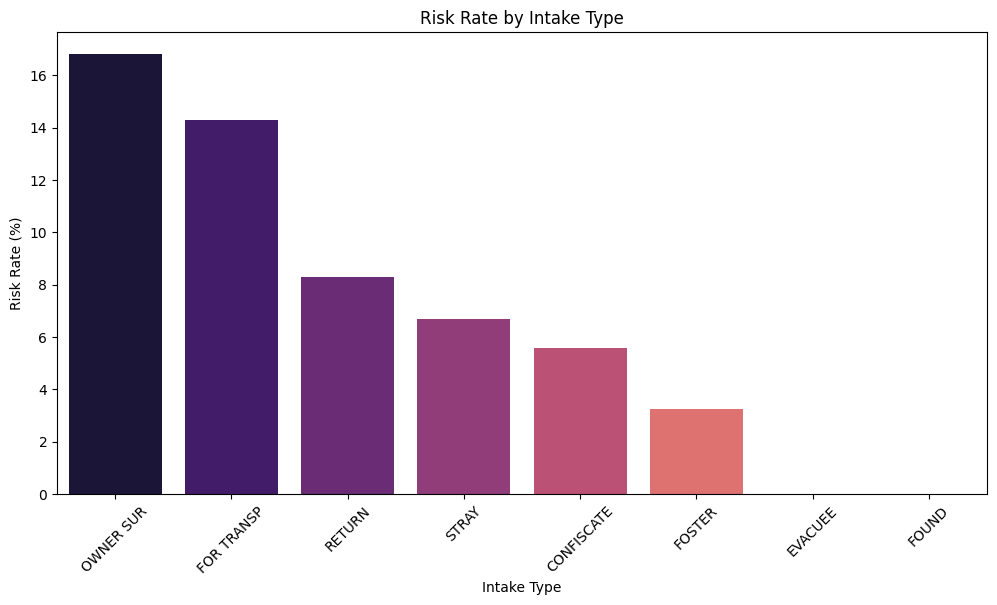

In [21]:
plt.figure(figsize=(12, 6))
risk_rate_intype = df.groupby('intype')['will_die'].mean().sort_values(ascending=False) * 100
sns.barplot(x=risk_rate_intype.index, y=risk_rate_intype.values, palette='magma')

plt.title('Risk Rate by Intake Type')
plt.ylabel('Risk Rate (%)')
plt.xlabel('Intake Type')
plt.xticks(rotation=45)
plt.show()

Here we examine whether the circumstances of arrival at the shelter affect the animal's chances of survival. It can be seen that animals that arrive under certain circumstances (e.g., Owner surrendered or For transported) are at much higher risk than those found as strays. This information is essential for the shelter to prioritize resources and provide preventative care for animals that arrive from these risk groups.

### Impact of Biting History on Animal Risk

/tmp/ipython-input-4178946236.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=risk_bites.index, y=risk_bites.values, palette=colors_me)


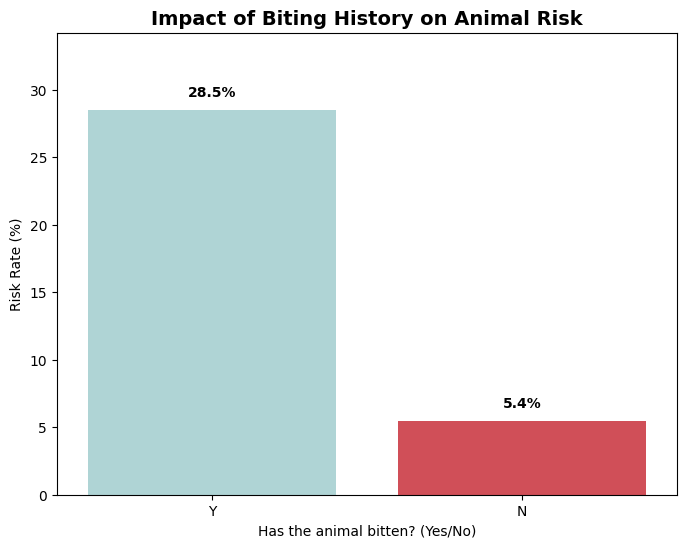

In [22]:
plt.figure(figsize=(8, 6))
risk_bites = df.groupby('bites')['will_die'].mean().sort_index(ascending=False) * 100

sns.barplot(x=risk_bites.index, y=risk_bites.values, palette=colors_me)
plt.title('Impact of Biting History on Animal Risk', fontsize=14, fontweight='bold')
plt.ylabel('Risk Rate (%)')
plt.xlabel('Has the animal bitten? (Yes/No)')

for i, v in enumerate(risk_bites.values):
    plt.text(i, v + 1, f'{v:.1f}%', ha='center', fontweight='bold')

plt.ylim(0, max(risk_bites.values) * 1.2)
plt.show()

This is one of the strongest predictors in our model. The use of red highlights that an animal with a history of biting is at significantly (many times) higher risk than an animal without such a history. For the shelter, this is an immediate “red flag” that requires urgent behavioral assessment.

### Distribution of Animals At Risk by Intake Month

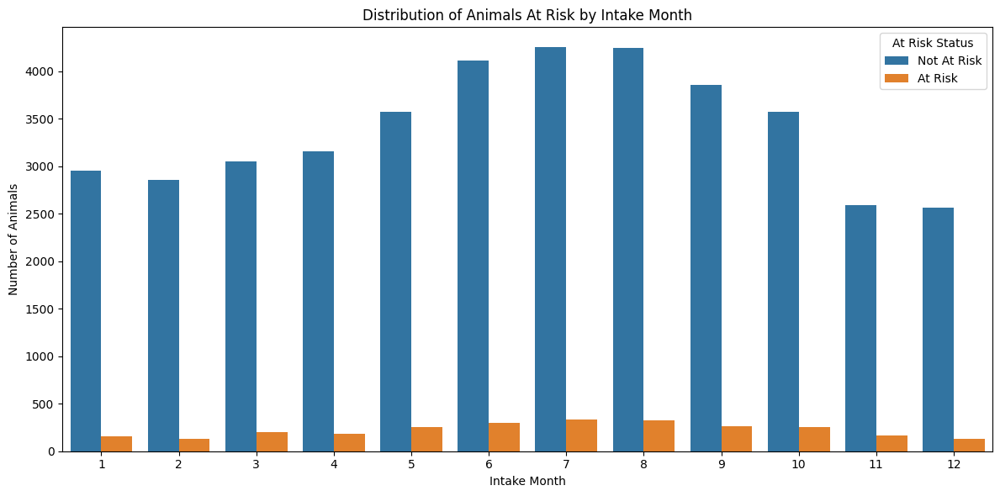

In [23]:
df['month'] = df['indate'].dt.month
plt.figure(figsize=(12, 6))

sns.countplot(
    x='month',
    hue='will_die',
    data=df
)

plt.title('Distribution of Animals At Risk by Intake Month')
plt.xlabel('Intake Month')
plt.ylabel('Number of Animals')
plt.legend(title='At Risk Status', labels=['Not At Risk', 'At Risk'])
plt.tight_layout()
plt.show()

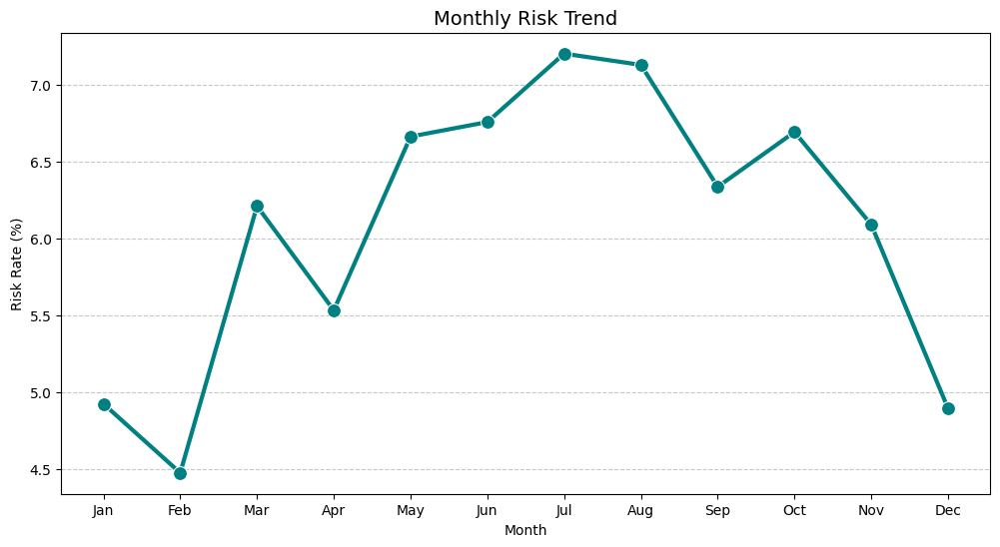

In [24]:
plt.figure(figsize=(12, 6))

risk_month = df.groupby('month')['will_die'].mean() * 100

sns.lineplot(x=risk_month.index, y=risk_month.values, marker='o', markersize=10, color='teal', linewidth=3)
plt.title('Monthly Risk Trend', fontsize=14)
plt.ylabel('Risk Rate (%)')
plt.xlabel('Month')
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

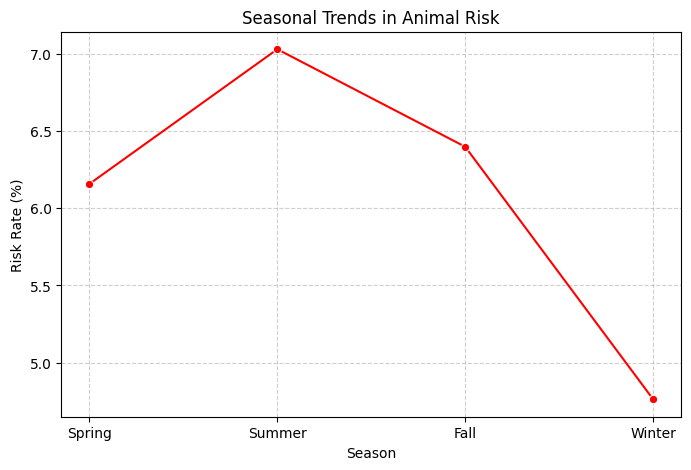

In [25]:
plt.figure(figsize=(8, 5))
order = ['Spring', 'Summer', 'Fall', 'Winter']
risk_rate_season = df.groupby('season')['will_die'].mean().reindex(order) * 100
sns.lineplot(x=risk_rate_season.index, y=risk_rate_season.values, marker='o', color='red')

plt.title('Seasonal Trends in Animal Risk')
plt.ylabel('Risk Rate (%)')
plt.xlabel('Season')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

The graph analyzes whether there is a relationship between the seasons of the year and the level of risk of animals in the shelter. Seasonality can result from overloading the shelter during certain periods (such as "pup season") or from weather conditions that affect the condition of the arriving animals. Identifying such a trend allows for better logistical preparation throughout the year.

### Geographic analysis of risk hotspots

/tmp/ipython-input-80585239.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap('YlOrRd')
/tmp/ipython-input-80585239.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=filtered_juris_rates.values, y=filtered_juris_rates.index.astype(str), palette=colors)


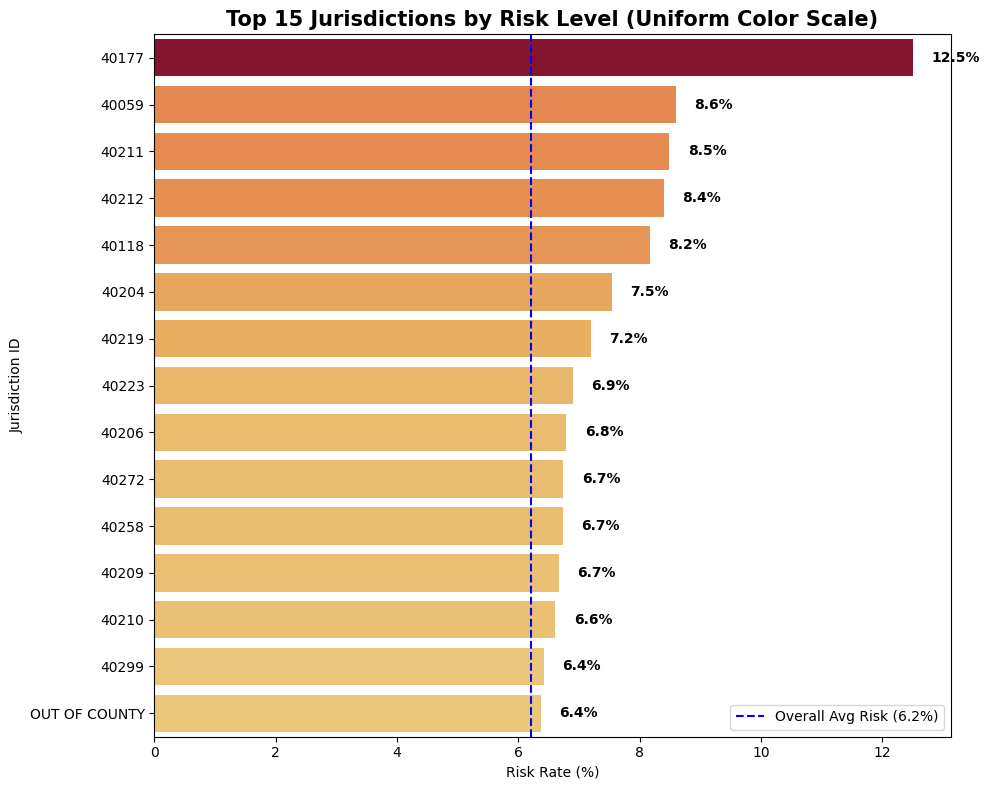

In [26]:
import matplotlib.cm as cm
import matplotlib.colors as mcolors

v_min, v_max = 3.7, 13
norm = mcolors.Normalize(vmin=v_min, vmax=v_max)
colormap = cm.get_cmap('YlOrRd')

juris_stats = df.groupby('jurisdiction')['will_die'].agg(['mean', 'count'])
filtered_juris = juris_stats[juris_stats['count'] > 20].sort_values(by='mean', ascending=False).head(15)
filtered_juris_rates = filtered_juris['mean'] * 100

colors = [colormap(norm(value)) for value in filtered_juris_rates.values]

plt.figure(figsize=(10, 8))
sns.barplot(x=filtered_juris_rates.values, y=filtered_juris_rates.index.astype(str), palette=colors)

overall_avg = df['will_die'].mean() * 100
plt.axvline(overall_avg, color='blue', linestyle='--', label=f'Overall Avg Risk ({overall_avg:.1f}%)')
plt.title('Top 15 Jurisdictions by Risk Level (Uniform Color Scale)', fontsize=15, fontweight='bold')
plt.xlabel('Risk Rate (%)')
plt.ylabel('Jurisdiction ID')
plt.legend()

for i, v in enumerate(filtered_juris_rates.values):
    plt.text(v + 0.3, i, f'{v:.1f}%', va='center', fontweight='bold')

plt.tight_layout()
plt.show()

In [27]:
# AI נוצר בשיתוף
import plotly.express as px

juris_summary = df.groupby('jurisdiction').agg(count=('will_die', 'count'), risk_rate=('will_die', 'mean')).reset_index()
juris_summary['risk_rate'] *= 100
juris_summary = juris_summary[juris_summary['count'] > 20]

fig = px.treemap(juris_summary,
                 path=['jurisdiction'],
                 values='count',
                 color='risk_rate',
                 color_continuous_scale='YlOrRd',
                 range_color=[3.7, 13.0],
                 title='Jurisdiction Risk Map: Uniform Color Scale (3.7% - 19.0%)')

fig.update_layout(margin=dict(t=50, l=10, r=10, b=10))
fig.show()

In [28]:
# AI נוצר בשיתוף
import folium
import pandas as pd

risk_stats = df.groupby('jurisdiction')['will_die'].agg(['mean', 'count']).reset_index()
risk_stats['risk_rate'] = risk_stats['mean'] * 100
risk_stats['jurisdiction'] = risk_stats['jurisdiction'].astype(str)

ky_zip_geojson = 'https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/ky_kentucky_zip_codes_geo.min.json'

m = folium.Map(location=[38.20, -85.70], zoom_start=11, tiles='CartoDB positron')

choropleth = folium.Choropleth(
    geo_data=ky_zip_geojson,
    name='Risk Rate by Zip Code',
    data=risk_stats,
    columns=['jurisdiction', 'risk_rate'],
    key_on='feature.properties.ZCTA5CE10',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.4,
    legend_name='Risk Rate (%)',
    nan_fill_color='white',
    highlight=True
).add_to(m)

shelter_lat, shelter_lon = 38.2045, -85.6661
folium.Marker(
    [shelter_lat, shelter_lon],
    popup='<b>Louisville Metro Animal Services</b>',
    tooltip='Shelter Location',
    icon=folium.Icon(color='blue', icon='home', prefix='fa')
).add_to(m)

folium.CircleMarker(
    [shelter_lat, shelter_lon],
    radius=15,
    color='blue',
    fill=True,
    fill_opacity=0.1
).add_to(m)

m

The geographical analysis highlights that the location from which the animal comes is an important variable for predicting its fate.

Hotspots: While some areas are characterized by a high volume of activity (as can be seen in TreeMap), the regional map reveals specific hotspots (like West Point) where the mortality rate is higher than average.

Insight: Marking the shelter on the map illustrates the physical proximity to these hotspots. Identifying the "red spots" allows you to refer to the areas in relation to the shelter.

### Distribution of Animals At Risk by sex and sterilized

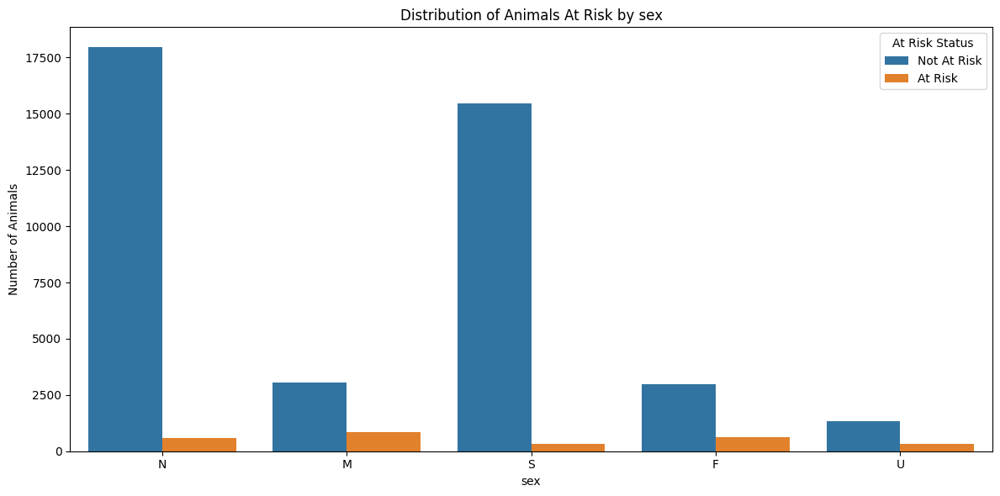

In [29]:
plt.figure(figsize=(12, 6))
sns.countplot(x='sex', hue='will_die', data=df)
plt.title('Distribution of Animals At Risk by sex')
plt.xlabel('sex')
plt.ylabel('Number of Animals')
plt.legend(title='At Risk Status', labels=['Not At Risk', 'At Risk'])
plt.tight_layout()
plt.show()

/tmp/ipython-input-2862334134.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




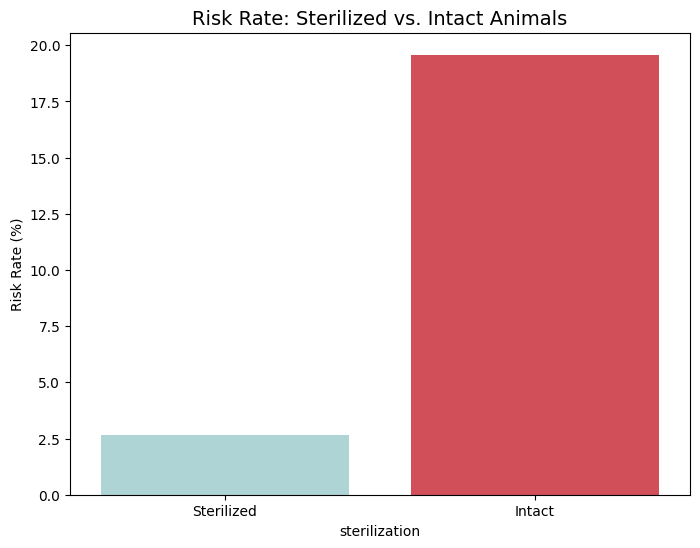

In [30]:
df['sterilization'] = df['sex'].map({'N': 'Sterilized', 'S': 'Sterilized', 'M': 'Intact', 'F': 'Intact'})

plt.figure(figsize=(8, 6))
risk_steril = df.groupby('sterilization')['will_die'].mean().sort_values() * 100
sns.barplot(x=risk_steril.index, y=risk_steril.values, palette=['#a8dadc','#e63946'])

plt.title('Risk Rate: Sterilized vs. Intact Animals', fontsize=14)
plt.ylabel('Risk Rate (%)')
plt.show()

The graphs show that spayed or neutered animals are at lower risk. These animals are often considered "ready to go," while "intact" animals require additional resources from the shelter (surgery, recovery) before they can go to a new home, which increases their length of stay and risk.

### Risk Rate by Pet Size

/tmp/ipython-input-962283905.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




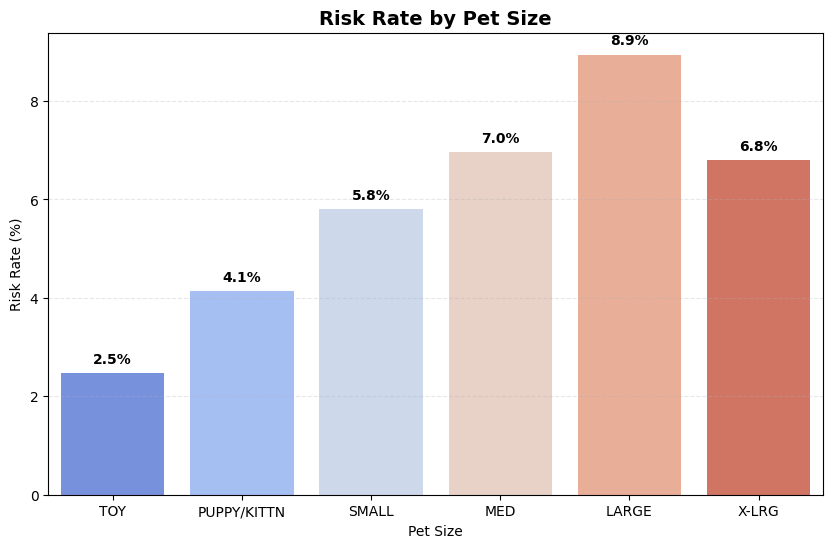

In [31]:
plt.figure(figsize=(10, 6))

size_order = ['TOY', 'PUPPY/KITTN', 'SMALL', 'MED', 'LARGE', 'X-LRG']
risk_by_size = df.groupby('petsize')['will_die'].mean().reindex(size_order) * 100

sns.barplot(x=risk_by_size.index, y=risk_by_size.values, palette='coolwarm')

plt.title('Risk Rate by Pet Size', fontsize=14, fontweight='bold')
plt.ylabel('Risk Rate (%)')
plt.xlabel('Pet Size')

for i, v in enumerate(risk_by_size.values):
    if not np.isnan(v):
        plt.text(i, v + 0.2, f'{v:.1f}%', ha='center', fontweight='bold')

plt.grid(axis='y', linestyle='--', alpha=0.3)
plt.show()

The data shows an interesting trend – as the size of the animal increases, so does its risk rate (especially in the LARGE category).

Key insights:

Large animals: Large dogs often suffer from lower adoption rates due to adopters’ living restrictions (small apartments) or concerns about their behavior, which leads to longer stays in the shelter and increased risk.

Kittens/Puppies: Although they are considered “adoptable,” their risk rate is not zero, which may indicate a higher medical susceptibility to diseases in the shelter.

# Dropping irrelevant columns

Feature Selection & Preventing Data Leakage We remove features that are either non-predictive (IDs) or cause "Data Leakage." Data leakage occurs when the model is trained on information that wouldn't be available at the time of prediction (like the final outtype). We also drop redundant temporal columns after extracting relevant features.

In [32]:
df_clean = df.drop(columns=['animalid', 'ObjectId', 'indate', 'outdate', 'sourcezipcode', 'outtype', 'outsubtype'])
df_clean.columns

Index(['kennel', 'jurisdiction', 'intype', 'insubtype', 'surreason',
       'animaltype', 'sex', 'bites', 'petsize', 'color', 'breed', 'first_time',
       'mixed_breed', 'will_die', 'season', 'month', 'sterilization'],
      dtype='object')

# LightBGM

In [33]:
# 1. Define Features and Target
X = df_clean.drop(columns=['will_die'])
y = df_clean['will_die']

# 2. Handle Categorical Variables
categorical_features = X.select_dtypes(include=['object']).columns.tolist()
for col in categorical_features:
    X[col] = X[col].astype('category')

# 3. Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# 4. Calculate Class Weights for Imbalance
neg_count = np.sum(y_train == 0)
pos_count = np.sum(y_train == 1)
calculated_weight = neg_count / pos_count

# 5. Initialize the Model
lgbm = lgb.LGBMClassifier(
    objective='binary',
    boosting_type='gbdt',
    scale_pos_weight=calculated_weight,
    random_state=42,
    n_jobs=-1,
    verbosity=-1
)

# 6. Define the Parameter Distributions
param_dist = {
    'n_estimators': randint(50, 100),
    'learning_rate': uniform(0.1, 0.2),
    'num_leaves': randint(10, 20),
    'max_depth': randint(5, 15),
    'min_child_samples': randint(10, 50),
}

# 7. Setup Randomized Search
random_search = RandomizedSearchCV(
    estimator=lgbm,
    param_distributions=param_dist,
    cv=4,
    scoring='average_precision',
    verbose=1,
    n_jobs=-1,
    random_state=42
)

# 8. Execute Search
print("Starting Randomized Search for LightGBM...")
random_search.fit(X_train, y_train)

# 9. Results
print(f"\nBest Parameters: {random_search.best_params_}")
best_model_lgb = random_search.best_estimator_

Starting Randomized Search for LightGBM...
Fitting 4 folds for each of 10 candidates, totalling 40 fits

Best Parameters: {'learning_rate': np.float64(0.10015575316820287), 'max_depth': 9, 'min_child_samples': 42, 'n_estimators': 61, 'num_leaves': 19}


In [34]:
# 10. Evaluation
# ---------------------------------------------------------
# Get hard predictions for Precision/Recall/F1
y_pred = best_model_lgb.predict(X_test)

# Get probabilities for the positive class (Class 1) for PR AUC
y_proba = best_model_lgb.predict_proba(X_test)[:, 1]

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred)
pr_auc = average_precision_score(y_test, y_proba)

print("--- At-Risk (Class 1) Performance ---")
print(f"Precision:         {precision[1]:.2f}")
print(f"Recall:            {recall[1]:.2f}")
print(f"F1-Score:          {f1[1]:.2f}")
print(f"PR AUC:            {pr_auc:.2f}")

--- At-Risk (Class 1) Performance ---
Precision:         0.34
Recall:            0.75
F1-Score:          0.46
PR AUC:            0.53


# CatBoost

In [35]:
# 1. Define Features and Target
X = df_clean.drop(columns=['will_die'])
X = X.fillna('NaN')
y = df_clean['will_die']

# 2. Identify Categorical Features
categorical_features = X.select_dtypes(include=['object', 'category']).columns.tolist()

# 3. Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# 4. Calculate Class Weights for Imbalance
neg_count = np.sum(y_train == 0)
pos_count = np.sum(y_train == 1)
calculated_weight = neg_count / pos_count

# 5. Initialize the Model
cat_model = CatBoostClassifier(
    loss_function='Logloss',
    cat_features=categorical_features,
    scale_pos_weight=calculated_weight,
    random_state=42,
    verbose=False
)

# 6. Define the Hyperparameter Grid
cat_dist = {
    'n_estimators': randint(50, 70),
    'depth': randint(5, 15),
    'learning_rate': uniform(0.1, 0.2),
    'min_data_in_leaf': randint(10, 20)
}

# 7. Use RandomizedSearchCV
rf_random = RandomizedSearchCV(
    estimator=cat_model,
    param_distributions=cat_dist,
    cv=2,
    scoring='average_precision',
    n_jobs=-1,
    random_state=42
)

# 8. Execute Random Search
print("Starting CatBoost Grid Search...")
rf_random.fit(X_train, y_train)

# 9. Evaluate
best_model_cat = rf_random.best_estimator_
print(f"\nBest Parameters: {rf_random.best_params_}")

Starting CatBoost Grid Search...

Best Parameters: {'depth': 9, 'learning_rate': np.float64(0.2215089703802877), 'min_data_in_leaf': 14, 'n_estimators': 58}


In [36]:
# 10. Evaluation
# ---------------------------------------------------------
# Get hard predictions for Precision/Recall/F1
y_pred = best_model_cat.predict(X_test)

# Get probabilities for the positive class (Class 1) for PR AUC
y_proba = best_model_cat.predict_proba(X_test)[:, 1]

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred)
pr_auc = average_precision_score(y_test, y_proba)

print("--- At-Risk (Class 1) Performance ---")
print(f"Precision:         {precision[1]:.2f}")
print(f"Recall:            {recall[1]:.2f}")
print(f"F1-Score:          {f1[1]:.2f}")
print(f"PR AUC:            {pr_auc:.2f}")

--- At-Risk (Class 1) Performance ---
Precision:         0.30
Recall:            0.78
F1-Score:          0.43
PR AUC:            0.53


# Additional Pre-processing

In [37]:
df_pre = df_clean.copy()

In [38]:
# Clean Kennel directlya
functional_areas = {'FOSTER', 'INTAKE', 'OFFICE', 'BARN', 'ACO UNIT'}
def get_kennel_group(k):
    k = str(k).strip().upper()
    if k in functional_areas: return k
    match = re.match(r'^([A-Z]+)', k)
    return match.group(1) if match else 'Other'

df_pre['kennel'] = df_pre['kennel'].apply(get_kennel_group)

In [39]:
# Clean Breed & Color directly
df_pre['breed'] = df_pre['breed'].apply(lambda x: str(x).split('/')[0].strip().upper())
df_pre['color'] = df_pre['color'].apply(lambda x: str(x).split('/')[0].strip().upper())

In [40]:
# Cardinality Reduction

def keep_top_n(df_pre, col, n):
    top = df_pre[col].value_counts().nlargest(n).index
    # Replace values not in 'top' with 'Other'
    df_pre[col] = df_pre[col].where(df_pre[col].isin(top), 'Other')

# Apply reduction inplace
keep_top_n(df_pre, 'breed', 20)
keep_top_n(df_pre, 'color', 10)
keep_top_n(df_pre, 'jurisdiction', 10)
keep_top_n(df_pre, 'kennel', 15)
keep_top_n(df_pre, 'insubtype', 10)
keep_top_n(df_pre, 'surreason', 20)

In [41]:
# downloading the new data - optional
# df_pre.to_csv('pre_animal_data.csv', index=False)
# files.download('pre_animal_data.csv')

In [42]:
# Define Target and Features
X = df_pre.drop(columns=['will_die'])
y = df_pre['will_die']

# Encoding Categorical Variables
X_encoded = pd.get_dummies(X, drop_first=True)

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(
    X_encoded, y, test_size=0.2, random_state=42, stratify=y
)

# Random Forest

In [43]:
# Initialize Random Forest
rf = RandomForestClassifier(random_state=42, class_weight='balanced')

# Create a pipeline that first applies SMOTE, then fits the model
pipeline = ImbPipeline([
    ('smote', SMOTE(random_state=42)),
    ('model', rf)
])

# ---------------------------------------------------------
# Hyperparameter Tuning
rf_dist = {
    'model__n_estimators': randint(50, 100),      # Range of trees
    'model__max_depth': randint(5, 15),            # Flexible depth
    'model__min_samples_split': randint(2, 20),    # Control splits
    'model__min_samples_leaf': randint(1, 10),     # Prevent Overfitting
    'model__max_features': ['sqrt']        # Feature selection methods
}

# Use RandomizedSearchCV
rf_random = RandomizedSearchCV(
    pipeline,
    param_distributions=rf_dist,
    cv=3,
    scoring='average_precision',
    n_jobs=-1,
    random_state=42
)

rf_random.fit(X_train, y_train)

best_model = rf_random.best_estimator_
print(f"\nBest Parameters found: {rf_random.best_params_}")

/usr/local/lib/python3.12/dist-packages/joblib/externals/loky/process_executor.py:782: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.




Best Parameters found: {'model__max_depth': 13, 'model__max_features': 'sqrt', 'model__min_samples_leaf': 2, 'model__min_samples_split': 10, 'model__n_estimators': 75}


In [44]:
# Evaluation
# ---------------------------------------------------------
# Get hard predictions for Precision/Recall/F1
y_pred = best_model.predict(X_test)

# Get probabilities for the positive class (Class 1) for PR AUC
y_proba = best_model.predict_proba(X_test)[:, 1]

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred)
pr_auc = average_precision_score(y_test, y_proba)

print("--- At-Risk (Class 1) Performance ---")
print(f"Precision:         {precision[1]:.2f}")
print(f"Recall:            {recall[1]:.2f}")
print(f"F1-Score:          {f1[1]:.2f}")
print(f"PR AUC:            {pr_auc:.2f}")

--- At-Risk (Class 1) Performance ---
Precision:         0.27
Recall:            0.70
F1-Score:          0.39
PR AUC:            0.42


# Logistic Regression

In [45]:
# Imbalance Handling & Model Pipeline
# ---------------------------------------------------------

# Initialize Logistic Regression
lr = LogisticRegression(random_state=42, class_weight='balanced')

# Create the pipeline
pipeline = ImbPipeline([
    ('smote', SMOTE(random_state=42)),
    ('model', lr)
])

# ---------------------------------------------------------
# 5. Hyperparameter Tuning (Grid Search)
# ---------------------------------------------------------
param_grid = {
    'model__C': [0.01, 0.1, 1],
    'model__penalty': ['l2'],
    'model__solver': ['lbfgs', 'liblinear']
}

print("\nStarting Grid Search for Logistic Regression...")
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    scoring='average_precision',
    cv=2,
    n_jobs=-1,
    verbose=1
)

grid_search.fit(X_train, y_train)

best_model = grid_search.best_estimator_
print(f"\nBest Parameters found: {grid_search.best_params_}")


Starting Grid Search for Logistic Regression...
Fitting 2 folds for each of 6 candidates, totalling 12 fits

Best Parameters found: {'model__C': 0.01, 'model__penalty': 'l2', 'model__solver': 'liblinear'}


In [46]:
# Evaluation
# ---------------------------------------------------------
# Get hard predictions for Precision/Recall/F1
y_pred = best_model.predict(X_test)

# Get probabilities for the positive class (Class 1) for PR AUC
y_proba = best_model.predict_proba(X_test)[:, 1]

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred)
pr_auc = average_precision_score(y_test, y_proba)

print("--- At-Risk (Class 1) Performance ---")
print(f"Precision:         {precision[1]:.2f}")
print(f"Recall:            {recall[1]:.2f}")
print(f"F1-Score:          {f1[1]:.2f}")
print(f"PR AUC:            {pr_auc:.2f}")

--- At-Risk (Class 1) Performance ---
Precision:         0.27
Recall:            0.57
F1-Score:          0.36
PR AUC:            0.33


# MLP

In [47]:
# 3. Setup the Pipeline with SMOTE and MLP
mlp = MLPClassifier(
    random_state=42,
    max_iter=50,
    early_stopping=True,
    batch_size=512
)

pipeline = ImbPipeline([
    ('smote', SMOTE(random_state=42)),
    ('model', mlp)
])

# 4. Define Search Space
param_dist = {
    'model__hidden_layer_sizes': [(50,), (20,30)],
    'model__activation': ['relu'],
    'model__alpha': loguniform(1e-4, 1e-1),
    'model__learning_rate_init': loguniform(1e-3, 1e-2)
}

print("Starting Randomized Search for MLP with Encoded Data...")

# 5. Run Randomized Search
random_search = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_dist,
    n_iter=5,
    scoring='average_precision',
    cv=2,
    n_jobs=-1,
    verbose=1,
    random_state=42
)

# Fit on the encoded data
random_search.fit(X_train, y_train)

best_model = random_search.best_estimator_
print(f"\nBest Parameters found: {random_search.best_params_}")

Starting Randomized Search for MLP with Encoded Data...
Fitting 2 folds for each of 5 candidates, totalling 10 fits

Best Parameters found: {'model__activation': 'relu', 'model__alpha': np.float64(0.00029375384576328325), 'model__hidden_layer_sizes': (50,), 'model__learning_rate_init': np.float64(0.002879047909793295)}


In [48]:
# 6. Evaluation
# ---------------------------------------------------------
# Get hard predictions for Precision/Recall/F1
y_pred = best_model.predict(X_test)

# Get probabilities for the positive class (Class 1) for PR AUC
y_proba = best_model.predict_proba(X_test)[:, 1]

# Calculate metrics
precision, recall, f1, _ = precision_recall_fscore_support(y_test, y_pred)
pr_auc = average_precision_score(y_test, y_proba)

print("--- At-Risk (Class 1) Performance ---")
print(f"Precision:         {precision[1]:.2f}")
print(f"Recall:            {recall[1]:.2f}")
print(f"F1-Score:          {f1[1]:.2f}")
print(f"PR AUC:            {pr_auc:.2f}")

--- At-Risk (Class 1) Performance ---
Precision:         0.46
Recall:            0.45
F1-Score:          0.45
PR AUC:            0.43


# Feature Importance

After looking at the perfomance of all the models, the best model is CatBoost, thanks to its PR-AUC score.

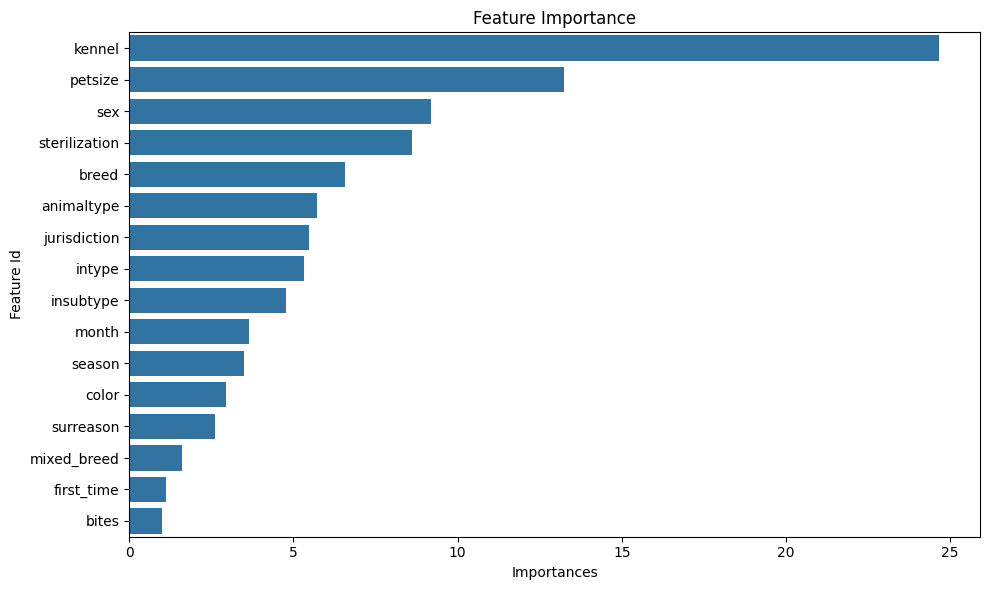

In [49]:
# 1. Get sorted importance DataFrame directly
importance_df = best_model_cat.get_feature_importance(prettified=True)

# 2. Plot
plt.figure(figsize=(10, 6))
sns.barplot(x='Importances', y='Feature Id', data=importance_df)
plt.title('Feature Importance')
plt.tight_layout()
plt.show()

Note: We chose to optimize PR AUC rather than Recall to ensure a balance between identifying at-risk cases and minimizing false alarms. While optimizing for Recall alone often forces the model to cast too wide a net, PR AUC ensures the model is fundamentally better at distinguishing the minority class effectively across all decision thresholds.

#  Unsupervised Analysis

In [51]:
X = df_pre.drop(columns=['will_die'])

# Fill NaN values in object columns with 'Missing' to handle the KModes requirement
for col in X.select_dtypes(include='object').columns:
    X[col] = X[col].fillna('Missing')

# Initialize K-Modes
km = KModes(n_clusters=9, n_init=2)

# Fit the clusters
clusters = km.fit_predict(X)

# Add the cluster labels back to your original dataframe
df_pre['risk_profile'] = clusters

In [52]:
# Calculate mortality rate per cluster
risk_analysis = df_pre.groupby('risk_profile')['will_die'].mean().reset_index()
risk_analysis.columns = ['Cluster', 'Mortality_Rate']

# Sort to find the "High Risk" profiles
risk_analysis = risk_analysis.sort_values(by='Mortality_Rate', ascending=False)
print(risk_analysis)

   Cluster  Mortality_Rate
3        3        0.165560
0        0        0.079260
6        6        0.058754
2        2        0.058154
7        7        0.044612
1        1        0.033436
5        5        0.031970
8        8        0.020165
4        4        0.019360


In [53]:
# Get the modes of each cluster
cluster_centroids = pd.DataFrame(km.cluster_centroids_, columns=X.columns)
cluster_centroids['Mortality_Rate'] = risk_analysis['Mortality_Rate'].values

# Display the characteristics of the highest-risk cluster
print("High Risk Profile Characteristics:")
print(cluster_centroids.iloc[0])

High Risk Profile Characteristics:
kennel                      C
jurisdiction            Other
intype                  STRAY
insubtype                 OTC
surreason               STRAY
animaltype                CAT
sex                         N
bites                       N
petsize                   MED
color                   BLACK
breed             DOMESTIC SH
first_time                  1
mixed_breed                 0
season                 Summer
month                       7
sterilization      Sterilized
Mortality_Rate        0.16556
Name: 0, dtype: object
